## **Oil-Storage Detector**

In [1]:
# Libraries
import torch
import glob
import re
import os
import ast
import random
import numpy as np
import pandas as pd
import seaborn as sns
import shutil as sh
from pathlib import Path
import PIL.Image
import PIL.ImageDraw
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.auto import tqdm
from IPython.display import Image, clear_output

In [2]:
# Clone the yoloV5 repo
#%%time

!git clone https://github.com/ultralytics/yolov5 # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies
!cp yolov5/requirements.txt ./

Cloning into 'yolov5'...
remote: Enumerating objects: 12390, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 12390 (delta 1), reused 7 (delta 1), pack-reused 12383
Receiving objects: 100% (12390/12390), 11.51 MiB | 11.68 MiB/s, done.
Resolving deltas: 100% (8622/8622), done.


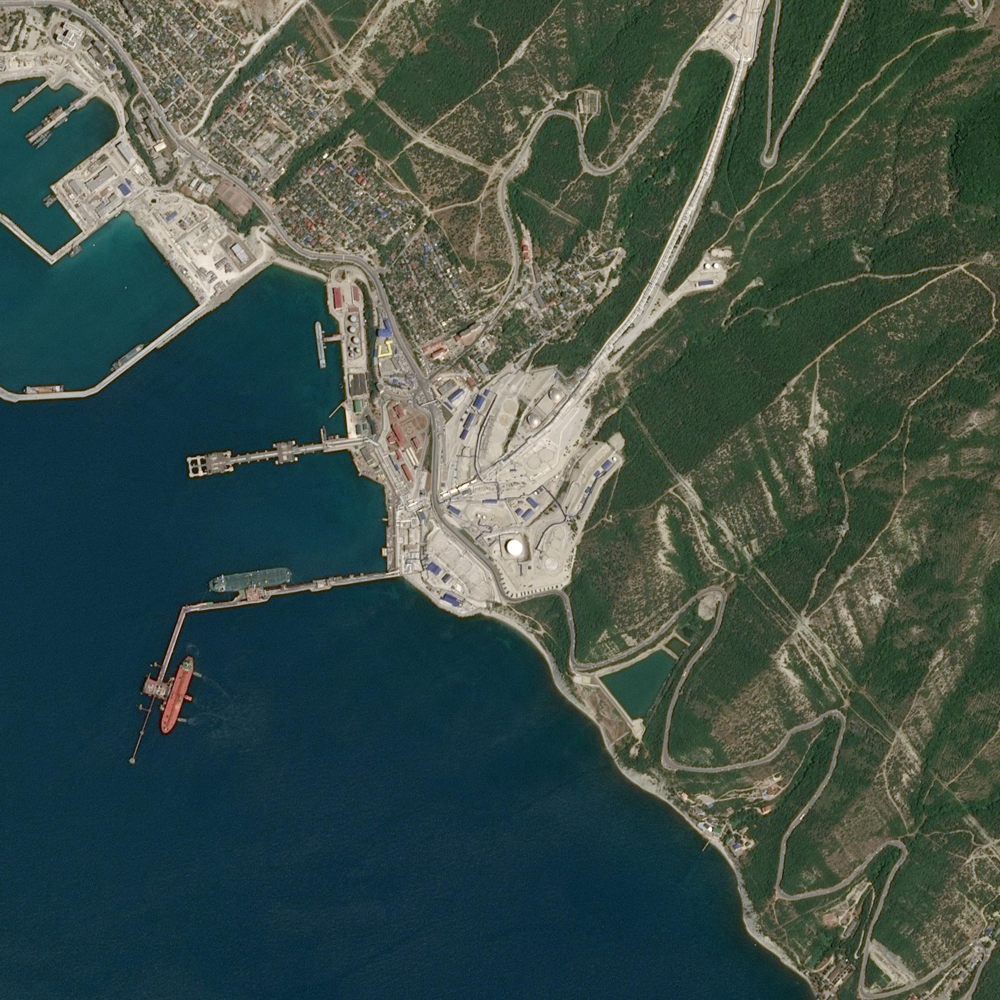

In [3]:
# Location of dataset
base_path = Path('oil_storage_data')
base_path_str = 'oil_storage_data'

# List all images in the folder
image_list = list(base_path.glob('images/*.jpg'))

# Create a list of image ids
image_ids = pd.DataFrame(image_list).rename(columns={0:"image_id"})

# Show a random image
pickone = random.choice(image_list)
img = PIL.Image.open(pickone)
filename = "oil-storage-sample.jpg"
img.save(filename)
display(img)

In [4]:
only_files = [base_path / f.name for f in image_list if os.path.isfile(f) and f.name[-4:] == ".jpg"]
print("Found {} images files in {}".format(len(only_files), base_path))

image_height, image_width = img.size
num_channels = len(img.mode)
print("Image size: {}".format((image_height, image_width)))
print("Num channels: {}".format(num_channels))

# Image is 2560x2560 with 3 color channels

Found 98 images files in oil_storage_data
Image size: (2560, 2560)
Num channels: 3


In [5]:
df = pd.read_csv(base_path / 'annotations.csv')
# convert a string record into a valid python object
def f(x): 
    return ast.literal_eval(x.rstrip('\r\n'))

df = pd.read_csv(base_path / "annotations.csv", 
                converters={'bounds': f})

df["image_id"] = df["image_id"] + ".jpg"

df.rename(columns = {"bounds": "geometry"}, inplace = True)

labels = pd.read_csv(base_path / "annotations.csv", 
                converters={'bounds': f})

df.head(10)

,image_id,class,geometry
0,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1205, 1493, 1231, 1516)"
1,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1479, 1756, 1507, 1776)"
2,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1478, 1786, 1518, 1815)"
3,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2132, 2163, 2148, 2178)"
4,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2010, 2127, 2024, 2141)"
5,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1991, 2130, 2009, 2150)"
6,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1971, 2139, 1992, 2158)"
7,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2099, 2004, 2108, 2013)"
8,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2108, 2005, 2115, 2012)"
9,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2103, 1645, 2113, 1656)"


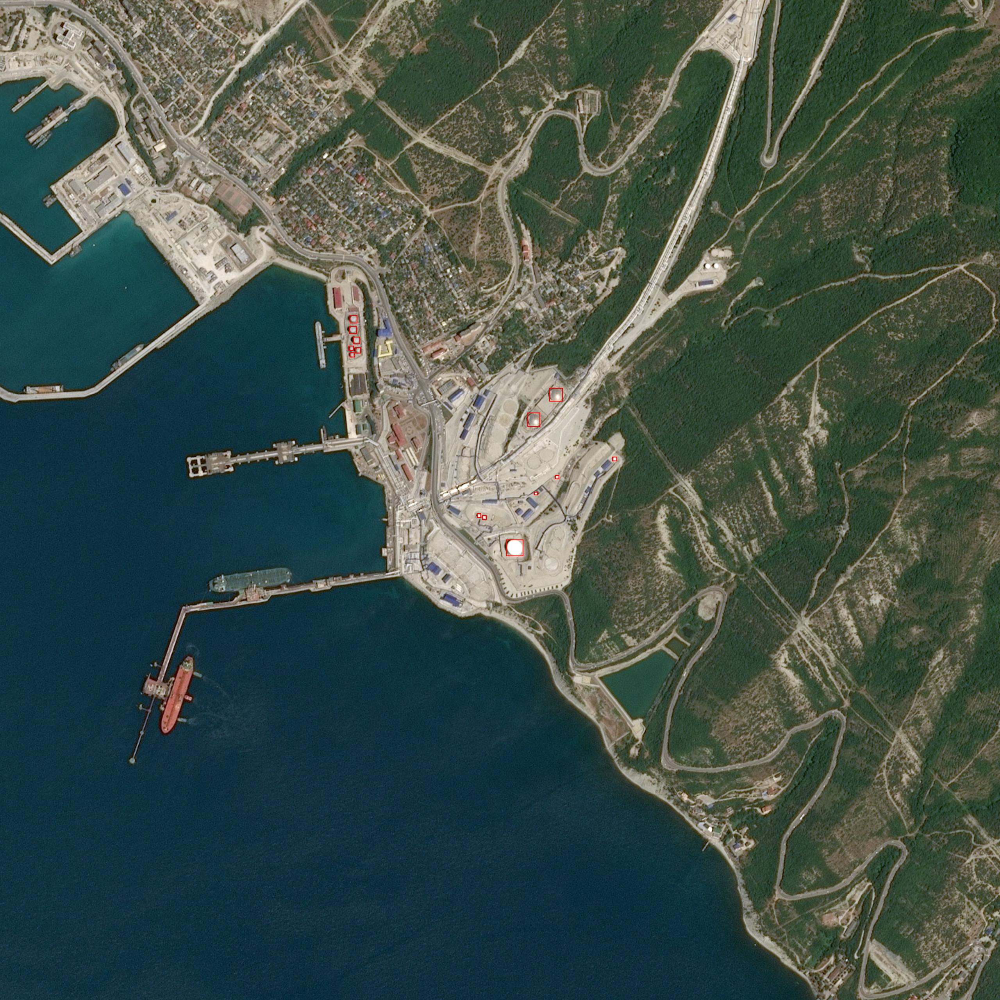

In [6]:
# Create polygon from bounds
def create_polygon_from_bounds(bbox):
    # Get the x and y min and maxes
    (xmin, ymin, xmax, ymax) = bbox
    # Make a coordinates list
    coords = []
    coords.append((xmin, ymin))
    coords.append((xmin, ymax))
    coords.append((xmax, ymax))
    coords.append((xmax, ymin))
    coords.append((xmin, ymin))
    return coords

def overlay_image(image_id, bbox_df):
    img = PIL.Image.open(base_path_str + "/images/" + str(image_id) + ".jpg")
    draw = PIL.ImageDraw.Draw(img)

    for k, row in bbox_df[bbox_df['image_id'] == image_id].iterrows():
        geometry = create_polygon_from_bounds(row['bounds'])
        draw.polygon(geometry, outline=(255,0,0), width=2)
        #draw.text(geometry[0], row['class'], fill=(255,0,0))
        
    return img

# Convert the previous pickone to a string, striping everying but ID
pickone = str(pickone).lstrip(f"{base_path}/images/").rstrip(".jpg")

# Show image overlayed with bounding boxes
img = overlay_image(pickone, labels)
filename = "oil-storage-sample_annotated.jpg"
img.save(filename)
display(img)

In [7]:
# create a list of images used for validation
fold = 1
num_fold = 5
index = df['image_id'].unique()
val_indexes = index[len(index)*fold//num_fold:len(index)*(fold+1)//num_fold]
print(val_indexes)

['400cbcc8-6b72-433b-ac46-92bef8ee6c66.jpg'
 'e1a1bf76-a58c-4582-ace2-7fa29ea66200.jpg'
 '5853d123-e81e-401a-a8c7-37b8d2248000.jpg'
 'c1c959c0-6a0c-497b-82c7-129e076ae192.jpg'
 '183a6155-c7ab-41cd-ab0c-9fc500621ae7.jpg'
 'b64ce3b3-251a-42e4-9439-fb068512983c.jpg'
 '3e040964-7583-401a-8ecb-19fccdc9d8a2.jpg'
 '28483ab7-42f0-4343-af24-f8076dbdf2f9.jpg'
 '9892f3a0-f541-43b8-bc62-d640701841f7.jpg'
 'a2c80dde-a31e-4bb7-bac4-af3aa3d14ff7.jpg'
 '76a1f831-9193-47b7-a576-30e846210d5b.jpg'
 'b78898b5-1941-4cbc-8231-5c966c7f13ef.jpg'
 '664e361b-973a-409e-9df7-dc9513a53583.jpg'
 '22b8b29e-43de-4cf5-b91a-2ff5a188c2c5.jpg'
 '5529501e-5b67-4a9f-bedd-efb785b78ce2.jpg'
 'fb0d4981-0106-47a7-acec-c1bb0e0f8c87.jpg'
 'b1f41adb-2ca9-41d4-aaad-6e3ccf6c7701.jpg'
 '8e40cbf3-aea6-497c-83ed-5f9929e4ccde.jpg'
 '99831d12-b531-4da7-925e-3d25f946d1d0.jpg'
 'c61e23c7-f20f-425e-8380-be73772b69fd.jpg']


In [8]:
import tqdm.notebook

def getWidth(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(xmax - xmin)
    except:
        return np.nan

def getHeight(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(ymax - ymin)
    except:
        return np.nan

# Create bounds, width and height
df.loc[:,'width'] = df.loc[:,'geometry'].apply(getWidth)
df.loc[:,'height'] = df.loc[:,'geometry'].apply(getHeight)
df.head(10)

,image_id,class,geometry,width,height
0,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1205, 1493, 1231, 1516)",26,23
1,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1479, 1756, 1507, 1776)",28,20
2,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1478, 1786, 1518, 1815)",40,29
3,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2132, 2163, 2148, 2178)",16,15
4,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2010, 2127, 2024, 2141)",14,14
5,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1991, 2130, 2009, 2150)",18,20
6,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(1971, 2139, 1992, 2158)",21,19
7,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2099, 2004, 2108, 2013)",9,9
8,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2108, 2005, 2115, 2012)",7,7
9,0918a15c-8cfb-4da7-92cf-1f5098a76760.jpg,oil-storage-tank,"(2103, 1645, 2113, 1656)",10,11


In [9]:
# Since image is 2560x2560 we need to crop them into tiles. Here I choose to crop into 512x512 with 64 pixel overlap

tile_width = 512
tile_height = 512
tile_overlap = 64
truncated_percent = 0.3
_overwriteFiles = True

# For using YoloV5 we need a specific folder structure for the cropped images
tiles_directories = {"train": Path("yolov5/train/images"),
                    'val': Path('yolov5/val/images/')}

for _, folder in tiles_directories.items():
    if not os.path.isdir(folder):
        os.makedirs(folder)
        
labels_directory = {"train": Path("yolov5/train/labels"),
                   'val': Path('yolov5/val/labels/')}

for _, folder in labels_directory.items():
    if not os.path.isdir(folder):
        os.makedirs(folder)

In [10]:
# Save one line in .txt file for each tag found inside the tile
def tag_is_inside_tile(bounds, x_start, y_start, width, height, truncated_percent):
    x_min, y_min, x_max, y_max = bounds
    x_min, y_min, x_max, y_max = x_min - x_start, y_min - y_start, x_max - x_start, y_max - y_start

    if (x_min > width) or (x_max < 0.0) or (y_min > height) or (y_max < 0.0):
        return None
    
    x_max_trunc = min(x_max, width) 
    x_min_trunc = max(x_min, 0) 
    if (x_max_trunc - x_min_trunc) / (x_max - x_min) < truncated_percent:
        return None

    y_max_trunc = min(y_max, width) 
    y_min_trunc = max(y_min, 0) 
    if (y_max_trunc - y_min_trunc) / (y_max - y_min) < truncated_percent:
        return None
        
    x_center = (x_min_trunc + x_max_trunc) / 2.0 / width
    y_center = (y_min_trunc + y_max_trunc) / 2.0 / height
    x_extend = (x_max_trunc - x_min_trunc) / width
    y_extend = (y_max_trunc - y_min_trunc) / height
    
    return (0, x_center, y_center, x_extend, y_extend)

In [11]:
# Crop the images into 512x512 and store in YoloV5 compatible folders
for img_path in tqdm.notebook.tqdm(image_list):
    # Open image and related data
    pil_img = PIL.Image.open(img_path, mode='r')
    np_img = np.array(pil_img, dtype=np.uint8)

    # Get annotations for image
    img_labels = df[df["image_id"] == img_path.name]

    # Count number of sections to make
    X_tiles = (image_width + tile_width + tile_overlap - 1) // tile_width 
    Y_tiles = (image_height + tile_height + tile_overlap - 1) // tile_height
    
    # Cut each tile
    for x in range(X_tiles):
        for y in range(Y_tiles):

            x_end = min((x + 1) * tile_width - tile_overlap * (x != 0), image_width)
            x_start = x_end - tile_width
            y_end = min((y + 1) * image_height - tile_overlap * (y != 0), image_height)
            y_start = y_end - tile_height
            
            folder = 'val' if img_path.name in val_indexes else 'train'
            save_tile_path = tiles_directories[folder].joinpath(img_path.stem + "_" + str(x_start) + "_" + str(y_start) + ".jpg")
            save_label_path = labels_directory[folder].joinpath(img_path.stem + "_" + str(x_start) + "_" + str(y_start) + ".txt")
                
            # Save if file doesn't exit
            if _overwriteFiles or not os.path.isfile(save_tile_path):
                cut_tile = np.zeros(shape=(tile_width, tile_height, 3), dtype=np.uint8)
                cut_tile[0:tile_height, 0:tile_width, :] = np_img[y_start:y_end, x_start:x_end, :]
                cut_tile_img = PIL.Image.fromarray(cut_tile)
                cut_tile_img.save(save_tile_path)

            found_tags = [
                tag_is_inside_tile(bounds, x_start, y_start, tile_width, tile_height, truncated_percent)
                for i, bounds in enumerate(img_labels['geometry'])]
            found_tags = [el for el in found_tags if el is not None]

            # save labels
            with open(save_label_path, 'w+') as f:
                for tags in found_tags:
                    f.write(' '.join(str(x) for x in tags) + '\n')

  0%|          | 0/98 [00:00<?, ?it/s]

In [12]:
# See how many training images we have after cropping
n_train = len(os.listdir("yolov5/train/images"))
n_val = len(os.listdir("yolov5/val/images")) 
print(f"There are {n_train} training images after cropping")
print(f"There are {n_val} validation images after cropping")

There are 468 training images after cropping
There are 120 validation images after cropping


In [12]:
# Tensorboard (optional)
#%load_ext tensorboard
#%tensorboard --logdir runs/train

In [13]:
# Create the yaml file required by YoloV5
CONFIG = """
# train and val datasets (image directory or *.txt file with image paths)
train: train/
val: val/

# number of classes
nc: 1

# class names
names: ['oil-storage-tank']
"""

with open("Oil_Storage.yaml", "w") as f:
    f.write(CONFIG)

In [14]:
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.11.0+cu102 _CudaDeviceProperties(name='NVIDIA GeForce RTX 2080 SUPER', major=7, minor=5, total_memory=7959MB, multi_processor_count=48)


In [15]:
!python yolov5/train.py --img 512 --batch 32 --epochs 50 --data Oil_Storage.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=, data=Oil_Storage.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=32, imgsz=512, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-82-g71621df torch 1.11.0+cu102 CUDA:0 (NVIDIA GeForce RTX 2080 SUPER, 7960MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4,

In [16]:
!python yolov5/detect.py --source oil_storage_data/extras --img-size 2560 --weights yolov5/runs/train/exp/weights/best.pt --conf 0.5

detect: weights=['yolov5/runs/train/exp/weights/best.pt'], source=oil_storage_data/extras, data=yolov5/data/coco128.yaml, imgsz=[2560, 2560], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-82-g71621df torch 1.11.0+cu102 CUDA:0 (NVIDIA GeForce RTX 2080 SUPER, 7960MiB)

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/5 /home/theo/Documents/oil_storage-detector/oil_storage_data/extras/588fc1fb-b86a-4fb4-8161-d9bd3a1556ca.jpg: 2560x2560 134 oil-storage-tanks, Done. (0.053s)
image 2/5 /home/theo/Documents/oil_storage-detector/oil_storage_data/extras/605ffac0-69d5-4748-92c2-48d43f51afc1.jpg: 2560x2560 132 oil-storage-tanks, Done. (0.049